### Importando Bibliotecas

In [1]:
from PIL import Image
import numpy as np 
import matplotlib.pyplot as plt

### Criando funções a serem usadas

In [2]:
def gaussian_pdf(x, mu, sigma):
    return (1 / (sigma * np.sqrt(2 * np.pi))) * np.exp(-0.5 * ((x - mu) / sigma) ** 2)

def encontrar_nivel_cinza(fda, x, valor_fda_desejado):
    # Encontra o índice do valor de FDA mais próximo
    idx = np.searchsorted(fda, valor_fda_desejado, side='left')
    # Se o índice estiver fora dos limites, ajusta
    if idx >= len(x):
        idx = len(x) - 1
    if idx < 0:
        idx = 0
    return x[idx]

### Passo 1: Carregar a imagem

In [3]:
imagem = Image.open('lenna.jpg')
# imagem = Image.open('lennafull.jpg')

### Passo 2: Converter para escala de cinza

In [4]:
imagem_cinza = imagem.convert('L')

### Passo 3: Converter a imagem para um array NumPy

In [5]:
valores_pixels = np.array(imagem_cinza)

### Passo 4: Obter o array de valores 1D e normalizar de 0 a 1

In [6]:
valores_pixels_1d = valores_pixels.flatten() / 255

### Passo 5: Calcular a média e o desvio padrão dos valores dos pixels

In [7]:
media = np.mean(valores_pixels_1d)
desvio_padrao = np.std(valores_pixels_1d)

### Exibir os resultados

In [8]:
print("Tamanho da Imagem:", imagem_cinza.size)
print("Média:", media)
print("Desvio Padrão:", desvio_padrao)

Tamanho da Imagem: (512, 512)
Média: 0.48646373374789376
Desvio Padrão: 0.18716595137992745


### Passo 6: Construir e normalizar o vetor x com níveis de cinza de -1 até 1

In [9]:
x = np.linspace(-1, 1, 511)

print(x)

[-1.         -0.99607843 -0.99215686 -0.98823529 -0.98431373 -0.98039216
 -0.97647059 -0.97254902 -0.96862745 -0.96470588 -0.96078431 -0.95686275
 -0.95294118 -0.94901961 -0.94509804 -0.94117647 -0.9372549  -0.93333333
 -0.92941176 -0.9254902  -0.92156863 -0.91764706 -0.91372549 -0.90980392
 -0.90588235 -0.90196078 -0.89803922 -0.89411765 -0.89019608 -0.88627451
 -0.88235294 -0.87843137 -0.8745098  -0.87058824 -0.86666667 -0.8627451
 -0.85882353 -0.85490196 -0.85098039 -0.84705882 -0.84313725 -0.83921569
 -0.83529412 -0.83137255 -0.82745098 -0.82352941 -0.81960784 -0.81568627
 -0.81176471 -0.80784314 -0.80392157 -0.8        -0.79607843 -0.79215686
 -0.78823529 -0.78431373 -0.78039216 -0.77647059 -0.77254902 -0.76862745
 -0.76470588 -0.76078431 -0.75686275 -0.75294118 -0.74901961 -0.74509804
 -0.74117647 -0.7372549  -0.73333333 -0.72941176 -0.7254902  -0.72156863
 -0.71764706 -0.71372549 -0.70980392 -0.70588235 -0.70196078 -0.69803922
 -0.69411765 -0.69019608 -0.68627451 -0.68235294 -0.

### Ajustar a média e desvio padrão para o intervalo [-1, 1]

In [10]:
media_ajustada = (media - 0.5) * 2
desvio_padrao_ajustado = desvio_padrao * 2

### Passo 7: Calcular a função de densidade de probabilidade (FDP) para o ruído gaussiano

In [11]:
pdf_values = gaussian_pdf(x, media_ajustada, desvio_padrao_ajustado)
# pdf_values = gaussian_pdf(x, media, desvio_padrao)

print(pdf_values)

[0.03637053 0.03737241 0.03839767 0.03944673 0.04052    0.0416179
 0.04274087 0.04388931 0.04506367 0.04626437 0.04749185 0.04874655
 0.05002891 0.05133937 0.05267837 0.05404636 0.05544379 0.05687112
 0.05832878 0.05981724 0.06133695 0.06288837 0.06447195 0.06608816
 0.06773745 0.06942027 0.0711371  0.07288838 0.07467459 0.07649617
 0.07835358 0.08024729 0.08217774 0.08414541 0.08615072 0.08819415
 0.09027614 0.09239714 0.09455759 0.09675793 0.09899862 0.10128007
 0.10360273 0.10596703 0.10837338 0.11082222 0.11331396 0.115849
 0.11842776 0.12105064 0.12371803 0.12643032 0.12918789 0.13199112
 0.13484037 0.13773602 0.14067841 0.14366788 0.14670478 0.14978944
 0.15292217 0.15610329 0.15933309 0.16261187 0.16593991 0.16931748
 0.17274484 0.17622223 0.17974989 0.18332805 0.18695692 0.19063669
 0.19436756 0.1981497  0.20198326 0.20586839 0.20980523 0.21379389
 0.21783446 0.22192705 0.22607171 0.2302685  0.23451746 0.23881861
 0.24317196 0.24757749 0.25203517 0.25654495 0.26110678 0.2657205

### Passo 8: Calcular a função densidade acumulada (FDA) como a soma cumulativa da FDP

In [12]:
fda_values = np.cumsum(pdf_values)
print(np.max(pdf_values))

1.0657442595149889


### Passo 9: Normalizar a FDA para que o último valor seja 1

In [13]:
fda_values /= fda_values[-1]
print(np.max(fda_values))

1.0


### Plotar a FDP e a FDA

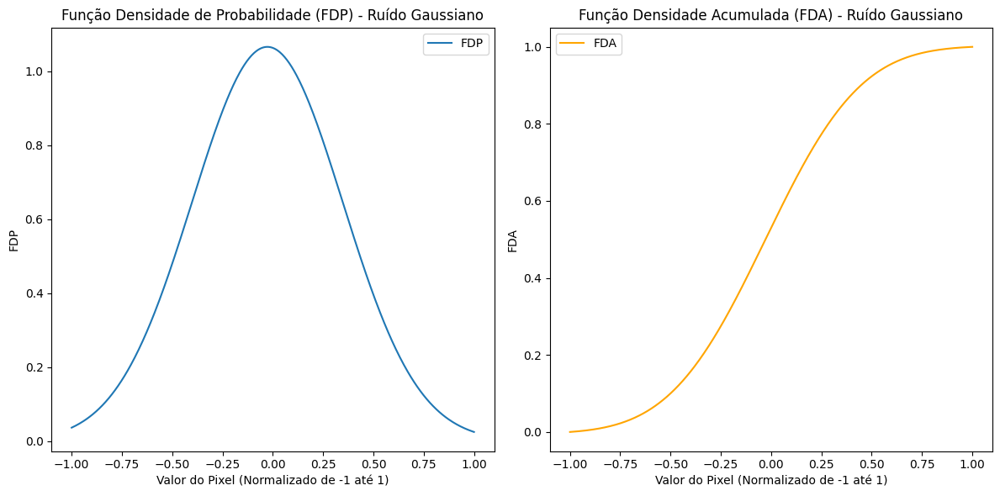

In [14]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(x, pdf_values, label="FDP")
plt.title("Função Densidade de Probabilidade (FDP) - Ruído Gaussiano")
plt.xlabel("Valor do Pixel (Normalizado de -1 até 1)")
plt.ylabel("FDP")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(x, fda_values, label="FDA", color="orange")
plt.title("Função Densidade Acumulada (FDA) - Ruído Gaussiano")
plt.xlabel("Valor do Pixel (Normalizado de -1 até 1)")
plt.ylabel("FDA")
plt.legend()

plt.tight_layout()
plt.show()

### Passo 10: Gerar valores de condições de apicação do ruido

In [15]:
num = np.random.uniform(0, 1, valores_pixels.size)

### Criação de um novo array para armazenar os valores de pixels modificados

In [16]:
valores_pixels_1d_modificado = valores_pixels_1d.copy()

### Encontrando valor do nivel de cinza em relação a um valor aleatório de FDA

In [17]:
amplitude = 0.2
condicional = 1     # chance de 0.00 ate 1.00

In [18]:
for i in range(valores_pixels.size):
    val = num[i]
    
    if(val <= condicional):

        valor_fda_desejado = np.random.uniform(0, 1) 

        # Encontrar o valor de nível de cinza para um valor específico de FDA
        nivel_cinza = encontrar_nivel_cinza(fda_values, x, valor_fda_desejado) * amplitude

        print(f"Nível de cinza correspondente ao valor FDA = {valor_fda_desejado}: {nivel_cinza}")

        valores_pixels_1d_modificado[i] += nivel_cinza

valores_pixels_1d_modificado = (valores_pixels_1d_modificado * 255)

Nível de cinza correspondente ao valor FDA = 0.7566400478231861: 0.04627450980392159
Nível de cinza correspondente ao valor FDA = 0.36483072008081685: -0.030588235294117652
Nível de cinza correspondente ao valor FDA = 0.33471192183988063: -0.03686274509803922
Nível de cinza correspondente ao valor FDA = 0.6832700130131351: 0.029803921568627434
Nível de cinza correspondente ao valor FDA = 0.034461614594769596: -0.13725490196078433
Nível de cinza correspondente ao valor FDA = 0.5918143307207595: 0.011764705882352944
Nível de cinza correspondente ao valor FDA = 0.39453923595823537: -0.025098039215686277
Nível de cinza correspondente ao valor FDA = 0.3157671043961655: -0.04078431372549021
Nível de cinza correspondente ao valor FDA = 0.7960062914627054: 0.0564705882352941
Nível de cinza correspondente ao valor FDA = 0.2045153305890537: -0.06666666666666668
Nível de cinza correspondente ao valor FDA = 0.8951258965868998: 0.08784313725490196
Nível de cinza correspondente ao valor FDA = 0.7515

In [19]:
# Passo 11: Converter o array 1D modificado de volta para uma imagem
valores_pixels_modificado = valores_pixels_1d_modificado.reshape(valores_pixels.shape)
imagem_modificada = Image.fromarray(valores_pixels_modificado.astype(np.uint8))

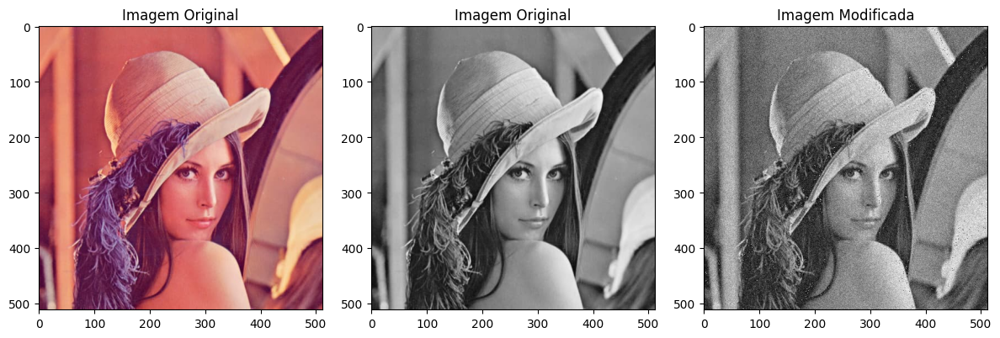

In [22]:
# Exibir a imagem original e modificada lado a lado
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.imshow(imagem, cmap="gray")
plt.title("Imagem Original")

plt.subplot(1, 3, 2)
plt.imshow(imagem_cinza, cmap="gray")
plt.title("Imagem Original")

plt.subplot(1, 3, 3)
plt.imshow(imagem_modificada, cmap="gray")
plt.title("Imagem Modificada")

plt.tight_layout()
plt.show()

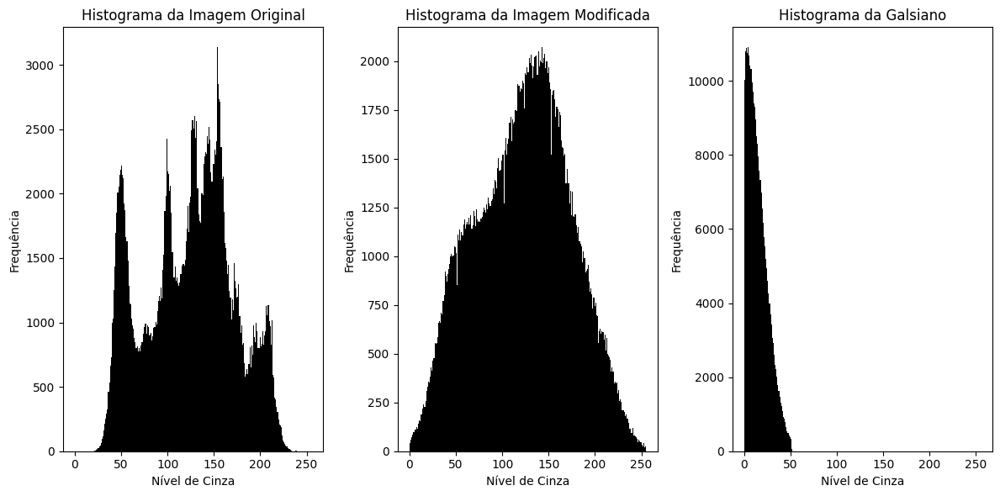

In [23]:
# Plotar os histogramas da imagem original e modificada
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.hist(valores_pixels.flatten(), bins=256, range=(0, 255), color='black')
plt.title("Histograma da Imagem Original")
plt.xlabel("Nível de Cinza")
plt.ylabel("Frequência")

plt.subplot(1, 3, 2)
plt.hist(valores_pixels_modificado.flatten(), bins=256, range=(0, 255), color='black')
plt.title("Histograma da Imagem Modificada")
plt.xlabel("Nível de Cinza")
plt.ylabel("Frequência")

aux = abs(valores_pixels - valores_pixels_modificado)

plt.subplot(1, 3, 3)
plt.hist(aux.flatten(), bins=256, range=(0, 255), color='black')
plt.title("Histograma da Galsiano")
plt.xlabel("Nível de Cinza")
plt.ylabel("Frequência")

plt.tight_layout()
plt.show()